In [1]:
import xarray as xr
import pandas as pd
import numpy as np
import calendar as cld
import matplotlib.pyplot as plt
import proplot as pplt # New plot library (https://proplot.readthedocs.io/en/latest/)
pplt.rc['savefig.dpi'] = 300 # 1200 is too big! #https://proplot.readthedocs.io/en/latest/basics.html#Creating-figures
import matplotlib as mpl
mpl.rcParams['hatch.linewidth'] = 0.05  # previous pdf hatch linewidth

from scipy.stats import chi2
from scipy.stats import linregress
from numba import njit,prange

In [4]:
#Minimization algorithm
@njit()
def nelder_mead(f, x_start ,args=(),
                step=0.1, no_improve_thr=1e-8,
                no_improv_break=10, max_iter=200,
                alpha=1., gamma=2., rho=-0.5, sigma=0.5):
    '''
        Pure Python/Numpy implementation of the Nelder-Mead algorithm.
        Reference: https://en.wikipedia.org/wiki/Nelder%E2%80%93Mead_method
        https://www.youtube.com/watch?v=vOYlVvT3W80
        
        
        @param f (function): function to minimize, must return a scalar score
            and operate over a numpy array of the same dimensions as x_start
        @param x_start (numpy array): initial position
        @param step (float): look-around radius in initial step
        @no_improv_thr,  no_improv_break (float, int): break after no_improv_break iterations with
            an improvement lower than no_improv_thr
        @max_iter (int): always break after this number of iterations.
            Set it to 0 to loop indefinitely.
        @alpha, gamma, rho, sigma (floats): parameters of the algorithm
            (see Wikipedia page for reference)
        return: tuple (best parameter array, best score, iterations)
    '''

    # init
    dim = len(x_start)
    prev_best = f(x_start, *args)
    no_improv = 0
    
    points = np.zeros((dim+1,dim))
    scores = np.zeros((dim+1))
    
    points[0]=x_start ; scores[0]=prev_best
    
    for i in range(1,dim+1):
        points[i] = np.copy(x_start)
        points[i,i-1] += step
        scores[i] = f(points[i], *args)

    # simplex iter
    iters = 0
    # break after max_iter
    while iters < max_iter:
        iters += 1
        
        # order
        ss = np.argsort(scores)
        points = points[ss]
        scores = scores[ss]
        best = scores[0] 
        

        # break after no_improv_break iterations with no improvement
        # print( '...best so far:', best)

        if best < prev_best - no_improve_thr:
            no_improv = 0
            prev_best = best
        else:
            no_improv += 1

        if no_improv >= no_improv_break:
            return points[0],scores[0],iters

        # centroid
        x0 = np.sum(points[:-1],axis=0)/dim
        # reflection
        xr = x0 + alpha*(x0 - points[-1])
        rscore = f(xr, *args)
        if scores[0] <= rscore < scores[-2]:
            points[-1] = xr
            scores[-1] = rscore
            continue

        # expansion
        if rscore < scores[0]:
            xe = x0 + gamma*(x0 - points[-1])
            escore = f(xe, *args)
            if escore < rscore:
                points[-1] = xe
                scores[-1] = escore
                continue
            else:
                points[-1] = xr
                scores[-1] = rscore
                continue

        # contraction
        xc = x0 + rho*(x0 - points[-1])
        cscore = f(xc, *args)
        if cscore < scores[-1]:
            points[-1] = xc
            scores[-1] = cscore
            continue

        # reduction
        for i in range(1,dim+1):
            points[i] = points[0] + sigma*(points[i] - points[0])
            scores[i] = f(points[i], *args)
        
    return points[0],scores[0],iters

### Gumbel fit
@njit()
def gumbel_nllh(params,x):
    μ,σ = params
    s = (x-μ)/σ
    return np.sum(np.log(σ)+s+np.exp(-s))

@njit()
def fit_gumbel(x):
    '''
    Algorithm derived in this video : https://www.youtube.com/watch?v=p818JALlO44
    '''
    x_ = np.mean(x)
    σ = np.sqrt(np.sum((x-x_)**2)/(np.shape(x)[0]-1) *6)/np.pi
    if σ==0. or x_==np.nan:
        return np.array([ np.nan , np.nan])
    for i in range(4):
        e = np.exp(-x/σ)
        e_ = np.mean(e)
        xe_ = np.mean(x*e)
        σ -= (σ - x_ + xe_/e_) / (1+ ( e_*np.mean(x**2*e) - xe_**2 )/e_**2/σ**2)
    return np.array([ -σ*np.log(np.mean(np.exp(-x/σ))) , σ ])

### GEV fit
@njit()
def gev_nllh(params,x):
    μ,σ,ξ = params
    if ξ==0.:
        return gumbel_nllh(params[:2],x)
    a = 1+ξ*(x-μ)/σ
    a[a<0.001]=0.001
    nllhs = np.log(σ) + (1+1/ξ)*np.log(a) + a**(-1/ξ)
    nllhs[a==0.001] = 100
    return np.sum(nllhs)

### NS-GEV fit
@njit()
def nsgev_nllh(params,x):
    μ0,σ0,ξ,μt,σt = params
    y = np.arange(-(len(x)-1)/2,(len(x)+1)/2)
    if ξ==0.:
        s = (x-μ0-y*μt)/(σ0+y*σt)
        return np.sum(np.log(σ0+y*σt)+s+np.exp(-s))
    
    a = 1+ξ*(x-μ0-y*μt)/(σ0+y*σt)
    a[a<0.001]=0.001
    nllhs = np.log(σ0+y*σt) + (1+1/ξ)*np.log(a) + a**(-1/ξ)
    nllhs[a==0.001] = 100
    return np.sum(nllhs)

@njit()
def nsgev_nllh_fit(params,x,gev_params):
    μt,σt = params
    μ0,σ0,ξ = gev_params
    y = np.arange(-(len(x)-1)/2,(len(x)+1)/2)
    if ξ==0.:
        s = (x-μ0-y*μt)/(σ0+y*σt)
        return np.sum(np.log(σ0+y*σt)+s+np.exp(-s))
    
    a = 1+ξ*(x-μ0-y*μt)/(σ0+y*σt)
    a[a<0.001]=0.001
    nllhs = np.log(σ0+y*σt) + (1+1/ξ)*np.log(a) + a**(-1/ξ)
    nllhs[a==0.001] = 100
    return np.sum(nllhs)

@njit()
def fit_nsgev(x):
    μ,σ = fit_gumbel(x)
    params,nllh0 = nelder_mead(gev_nllh, np.array([μ,σ,0.]),args=(x,),step=0.05,no_improve_thr=1e-6)[:2]
    μ,σ,ξ = params
    μt,σt = nelder_mead(nsgev_nllh_fit, np.array([0.,0.]),args=(x,np.array([μ,σ,ξ,])),step=0.1,no_improve_thr=1e-3)[0]
    params,nllh1 = nelder_mead(nsgev_nllh, np.array([μ,σ,ξ,μt,σt]),args=(x,),step=0.001,no_improve_thr=1e-6)[:2]
    return params, 2*(nllh0-nllh1)
    
@njit(parallel=True)
def seasonal_nsgev_signif(les_season_max):
    nt,ns,nlat,nlon = np.shape(les_season_max)
    season_mu_sig_xi_mut_sigt = np.zeros((ns,nlat,nlon,5))
    season_signif = np.zeros((ns,nlat,nlon))
    for s in prange(ns):
        for j in prange(nlat):
            for i in prange(nlon):
                season_mu_sig_xi_mut_sigt[s,j,i] , season_signif[s,j,i] = fit_nsgev(les_season_max[:,s,j,i])
    return season_mu_sig_xi_mut_sigt,season_signif

def seasonal_nsgev_pvalue(les_season_max):
    params , signif = seasonal_nsgev_signif(les_season_max)
    return params , 1 - chi2.cdf(signif,2)

In [6]:
models = ['CNRM_ALADIN','CNRM_RACMO','ECearth_RACMO','NorESM_REMO','NorESM_HIRHAM','MPI_REMO','MPI_CCLM','HadGEM_CCLM','IPSL_WRF']
les_params = []
les_pvalue = []
for m,model in enumerate(models):
    print(model)
    les_season_max = np.load('/home/philinat/Stage-M2/season_max_EUROCORDEX/les_season_max_'+model+'.npy')[:,:,:,:]
    params,pvalue = seasonal_nsgev_pvalue(les_season_max) # params=μ0,σ0,ξ,μt,σt
    les_params.append(params)
    les_pvalue.append(pvalue)
nsgev_models = np.append(np.array(les_params),np.reshape(np.array(les_pvalue),np.shape(les_pvalue)+(1,)),axis=4)
np.save('/home/philinat/Stage-M2/saved_nsgev/nsgev_EUROCORDEX.npy',nsgev_models)

CNRM_ALADIN
CNRM_RACMO
ECearth_RACMO
NorESM_REMO
NorESM_HIRHAM
MPI_REMO
MPI_CCLM
HadGEM_CCLM
IPSL_WRF


In [33]:
print(np.shape(nsgev_models))

(9, 4, 47, 100, 6)


In [2]:
nsgev_models = np.load('/home/philinat/Stage-M2/saved_nsgev/nsgev_EUROCORDEX.npy')

latmin,latmax = 42.5,49
lonmin,lonmax = 2.5,16.5

EUROCORDEX_format = {'gridlinewidth':0.1, 'gridcolor':'gray8', 'gridalpha':0.5, 'coast':True,'borders':True ,'reso':'hi', 'labels':False, 'lonlines':2, 'latlines':2, 'abc':False, 'latlim':[42.5,49],'lonlim':[2.5,16.5]}

_,_,nlat,nlon,_ = np.shape(nsgev_models)
# latitudes = np.linspace(latmin,latmax,nlat)
latitudes = np.linspace(latmax,latmin,nlat)
longitudes = np.linspace(lonmin,lonmax,nlon)
lon,lat = np.meshgrid(longitudes,latitudes)

In [3]:
def Qgev(μ,σ,ξ,q):
    Q = np.zeros(np.shape(μ))
    gumbel = np.abs(ξ)<10**-3
    gev = np.logical_not(gumbel)
    Q[gumbel] = μ[gumbel] - σ[gumbel]*np.log(-np.log(q))
    Q[gev] = μ[gev] + σ[gev]/ξ[gev]*((-np.log(q))**(-ξ[gev]) -1)
    return Q

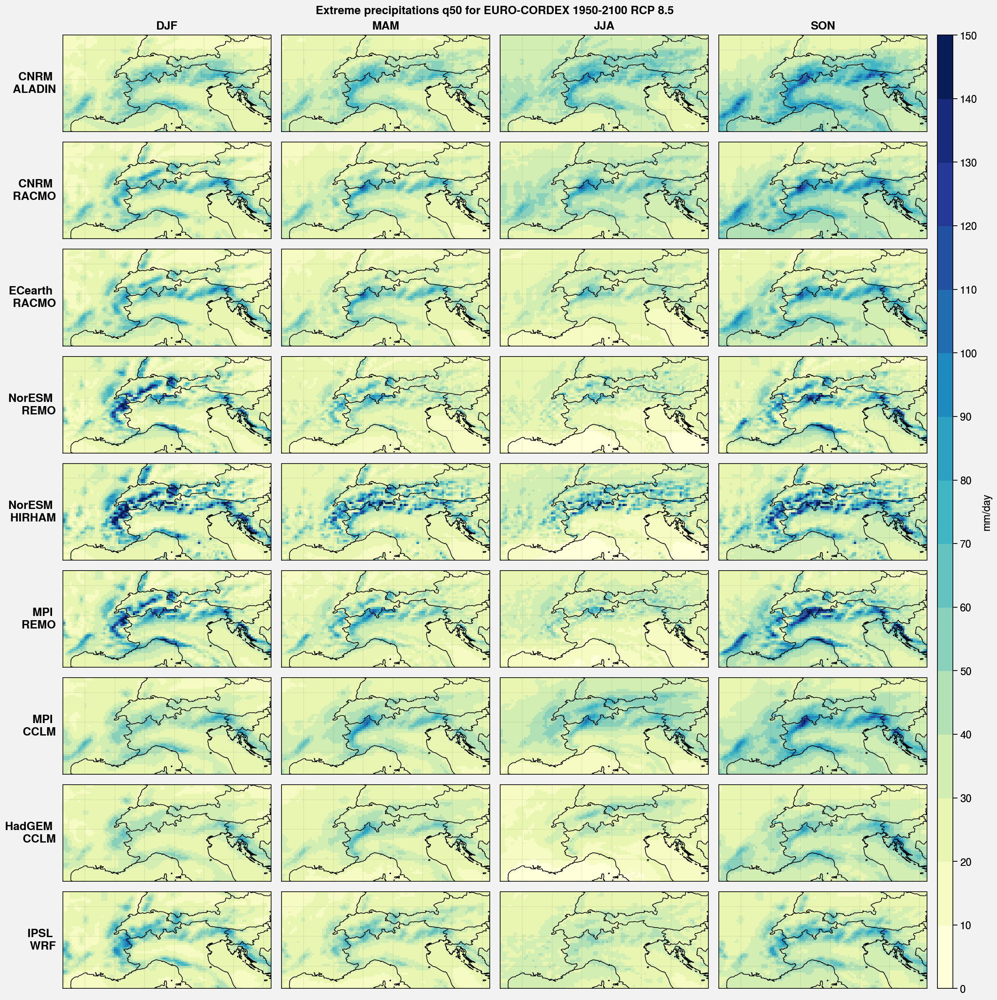

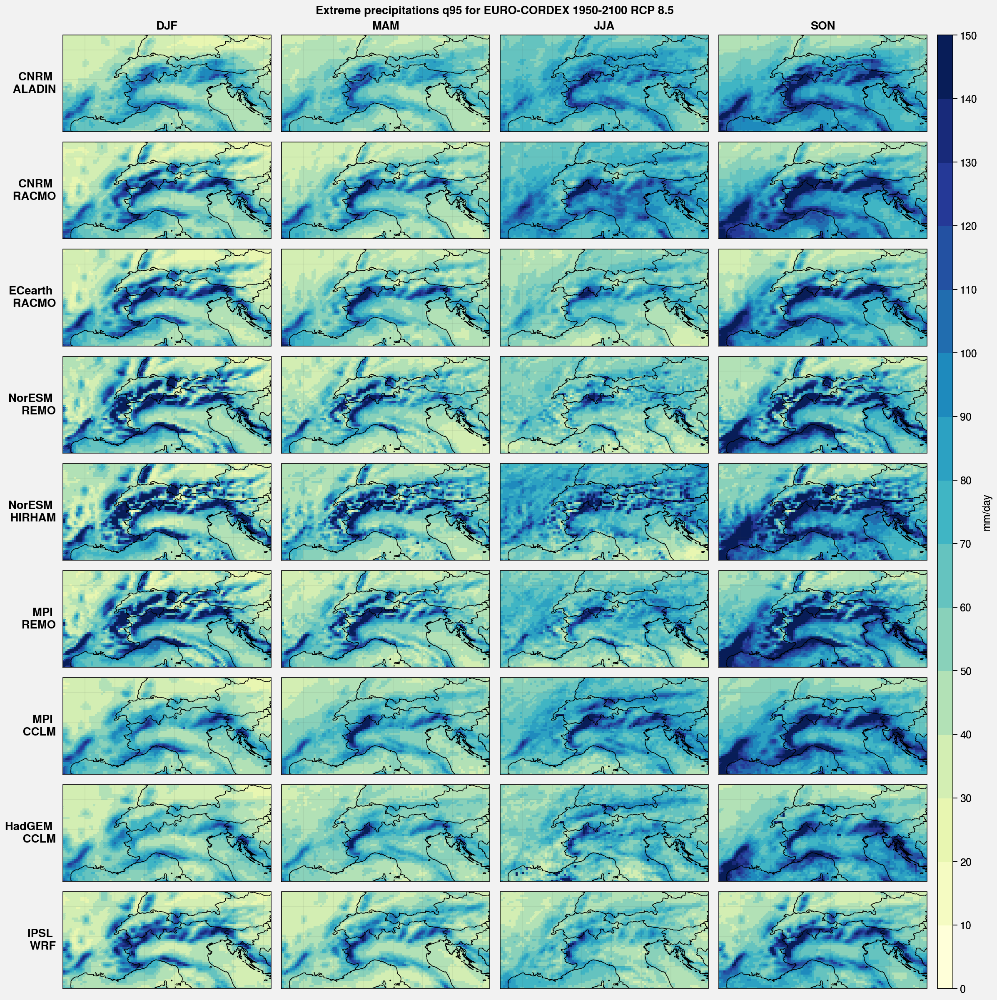

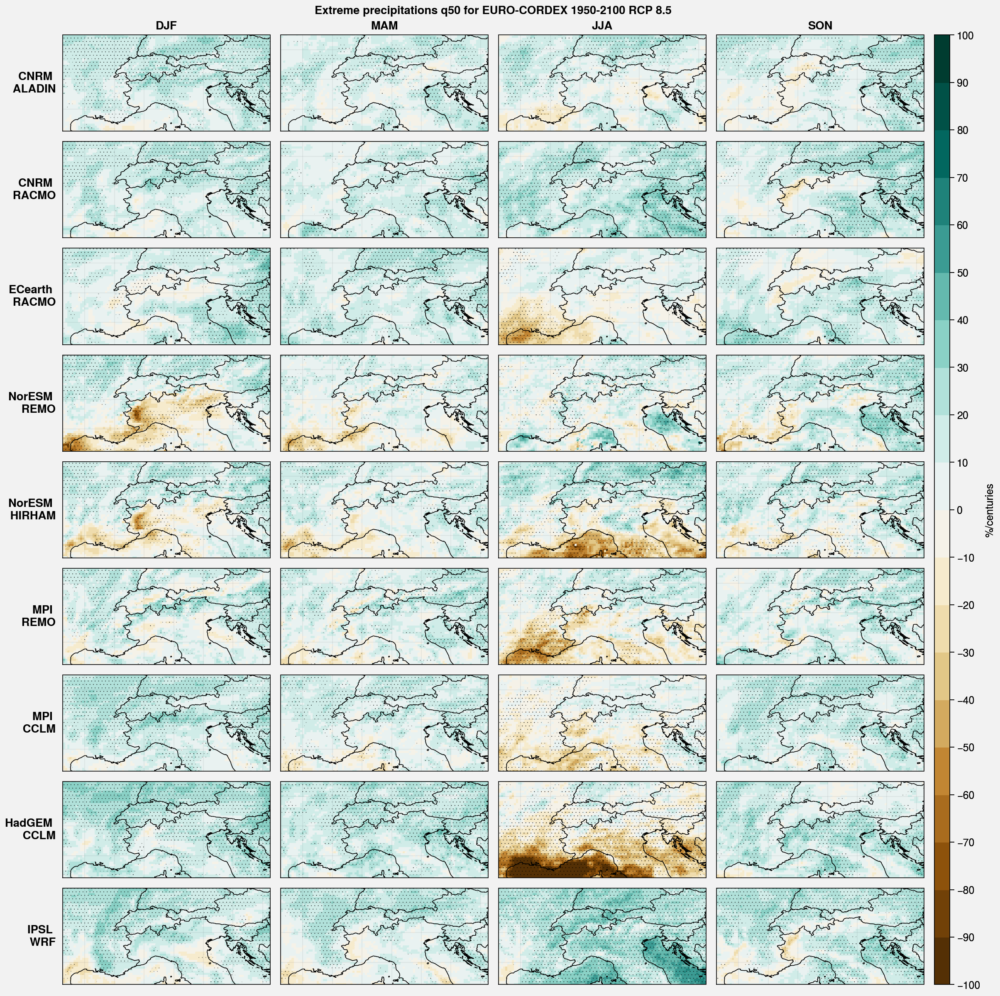

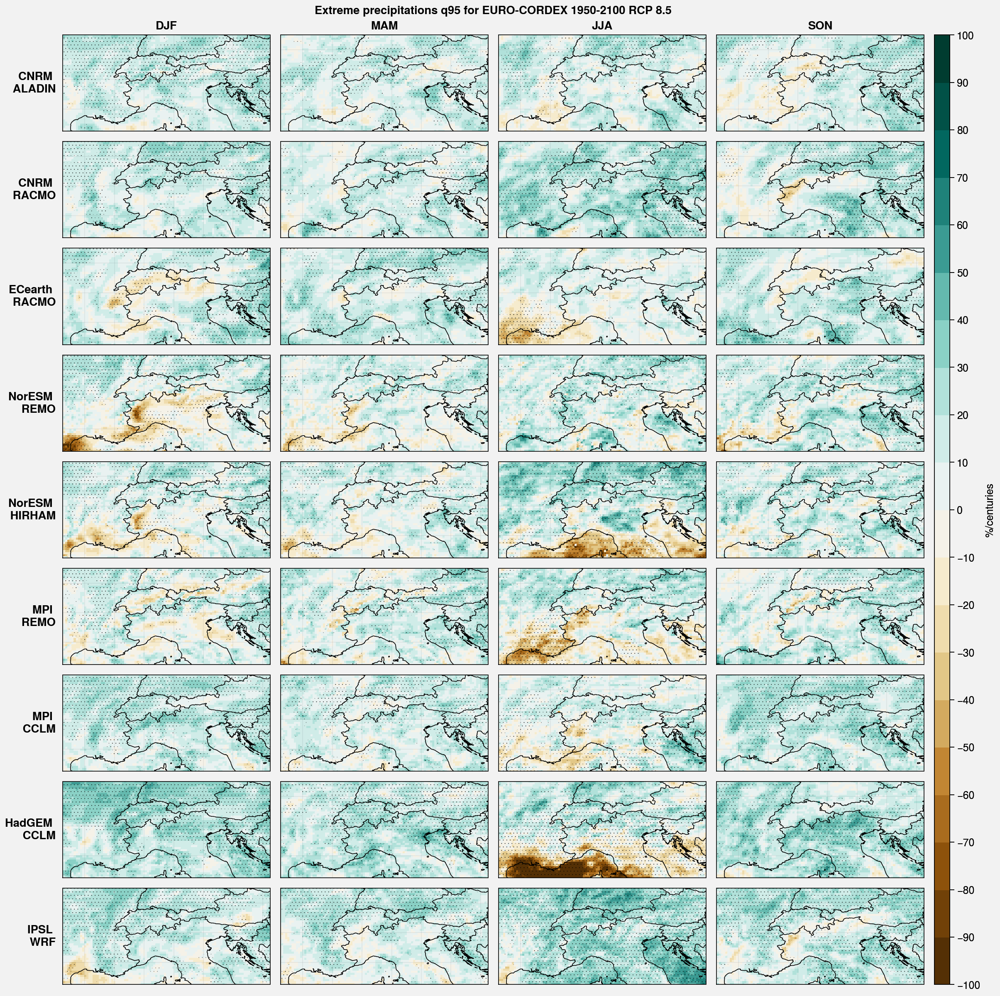

In [4]:
for trend in [False,True]:
    for q in [50,95]:
        f, axs = pplt.subplots(proj='cyl',ncols=4, nrows=len(nsgev_models))
        for m,params in enumerate(nsgev_models):
            for i in range(4):
                ax = axs[i+m*4]
                Q0 = Qgev(params[i,:,:,0],params[i,:,:,1],params[i,:,:,2],q/100)
                if trend:
                    Qt = Qgev(params[i,:,:,3],params[i,:,:,4],params[i,:,:,2],q/100)
                    cb = ax.pcolormesh(lon,lat,100*100*Qt/Q0,levels=np.linspace(-100,100,21),cmap='BrBg')
                    signif=np.where(params[i,:,:,5]<0.05,True,False)
                    ax.contourf(lon,lat,signif,hatches=["", "...."], alpha=0.)
                else:
                    cb = ax.pcolormesh(lon,lat,Q0,levels=np.linspace(0,150,16),cmap='YlGnBu')
        if trend: f.colorbar(cb, label= '%/centuries')  
        else: f.colorbar(cb, label= 'mm/day')            
        models = ['CNRM \n ALADIN','CNRM \n RACMO','ECearth \n RACMO','NorESM \n REMO','NorESM \n HIRHAM','MPI \n REMO','MPI \n CCLM','HadGEM \n CCLM','IPSL \n WRF']
        axs.format(**EUROCORDEX_format,suptitle='Extreme precipitations q'+str(q)+' for EURO-CORDEX 1950-2100 RCP 8.5',collabels=['DJF','MAM','JJA', 'SON'],rowlabels=models)

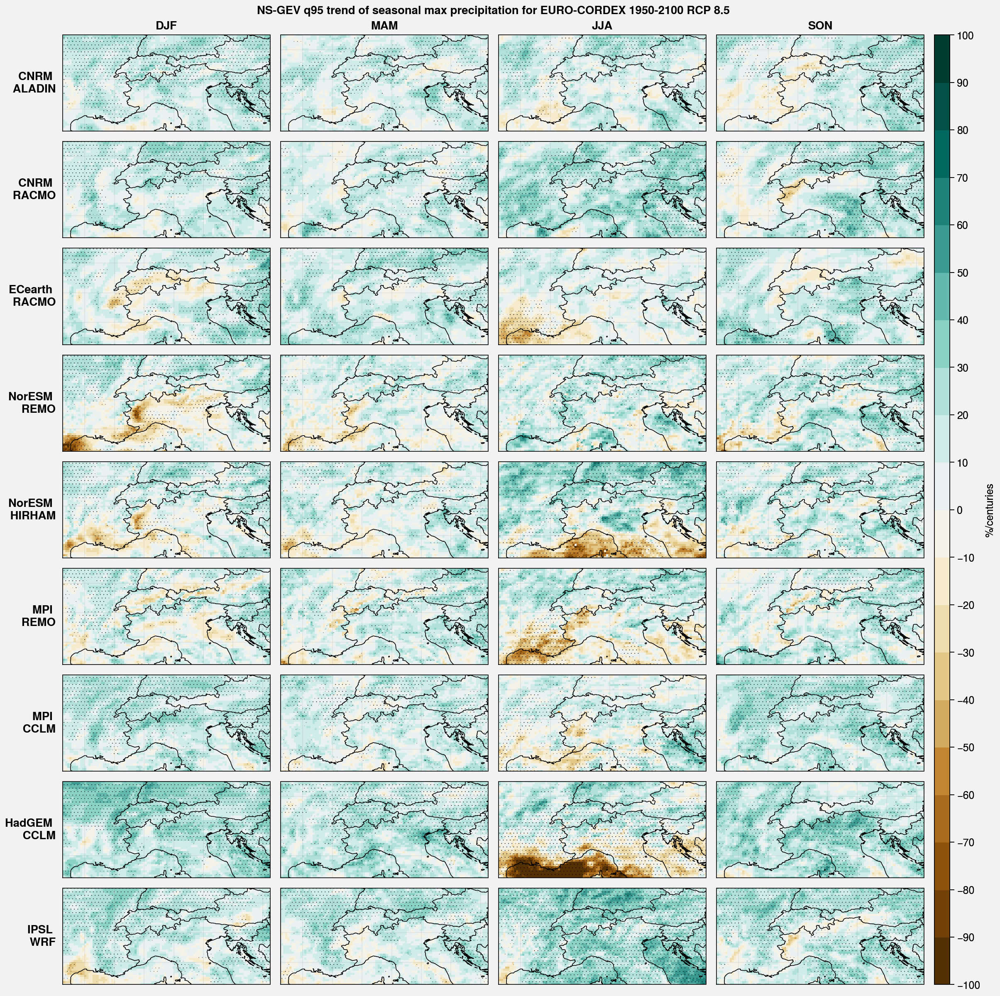

In [4]:
for trend in [True]:
    for q in [95]:
        f, axs = pplt.subplots(proj='cyl',ncols=4, nrows=len(nsgev_models))
        for m,params in enumerate(nsgev_models):
            for i in range(4):
                ax = axs[i+m*4]
                Q0 = Qgev(params[i,:,:,0],params[i,:,:,1],params[i,:,:,2],q/100)
                if trend:
                    Qt = Qgev(params[i,:,:,3],params[i,:,:,4],params[i,:,:,2],q/100)
                    cb = ax.pcolormesh(lon,lat,100*100*Qt/Q0,levels=np.linspace(-100,100,21),cmap='BrBg')
                    signif=np.where(params[i,:,:,5]<0.05,True,False)
                    ax.contourf(lon,lat,signif,hatches=["", "...."], alpha=0.)
                else:
                    cb = ax.pcolormesh(lon,lat,Q0,levels=np.linspace(0,150,16),cmap='YlGnBu')
        if trend: f.colorbar(cb, label= '%/centuries')  
        else: f.colorbar(cb, label= 'mm/day')            
        models = ['CNRM \n ALADIN','CNRM \n RACMO','ECearth \n RACMO','NorESM \n REMO','NorESM \n HIRHAM','MPI \n REMO','MPI \n CCLM','HadGEM \n CCLM','IPSL \n WRF']
        axs.format(**EUROCORDEX_format,suptitle='NS-GEV q'+str(q)+' trend of seasonal max precipitation for EURO-CORDEX 1950-2100 RCP 8.5',collabels=['DJF','MAM','JJA', 'SON'],rowlabels=models)

In [7]:
import numpy as np
import matplotlib.pyplot as plt

turbo_colormap_data = np.array(
                       [[0.18995,0.07176,0.23217],
                       [0.19483,0.08339,0.26149],
                       [0.19956,0.09498,0.29024],
                       [0.20415,0.10652,0.31844],
                       [0.20860,0.11802,0.34607],
                       [0.21291,0.12947,0.37314],
                       [0.21708,0.14087,0.39964],
                       [0.22111,0.15223,0.42558],
                       [0.22500,0.16354,0.45096],
                       [0.22875,0.17481,0.47578],
                       [0.23236,0.18603,0.50004],
                       [0.23582,0.19720,0.52373],
                       [0.23915,0.20833,0.54686],
                       [0.24234,0.21941,0.56942],
                       [0.24539,0.23044,0.59142],
                       [0.24830,0.24143,0.61286],
                       [0.25107,0.25237,0.63374],
                       [0.25369,0.26327,0.65406],
                       [0.25618,0.27412,0.67381],
                       [0.25853,0.28492,0.69300],
                       [0.26074,0.29568,0.71162],
                       [0.26280,0.30639,0.72968],
                       [0.26473,0.31706,0.74718],
                       [0.26652,0.32768,0.76412],
                       [0.26816,0.33825,0.78050],
                       [0.26967,0.34878,0.79631],
                       [0.27103,0.35926,0.81156],
                       [0.27226,0.36970,0.82624],
                       [0.27334,0.38008,0.84037],
                       [0.27429,0.39043,0.85393],
                       [0.27509,0.40072,0.86692],
                       [0.27576,0.41097,0.87936],
                       [0.27628,0.42118,0.89123],
                       [0.27667,0.43134,0.90254],
                       [0.27691,0.44145,0.91328],
                       [0.27701,0.45152,0.92347],
                       [0.27698,0.46153,0.93309],
                       [0.27680,0.47151,0.94214],
                       [0.27648,0.48144,0.95064],
                       [0.27603,0.49132,0.95857],
                       [0.27543,0.50115,0.96594],
                       [0.27469,0.51094,0.97275],
                       [0.27381,0.52069,0.97899],
                       [0.27273,0.53040,0.98461],
                       [0.27106,0.54015,0.98930],
                       [0.26878,0.54995,0.99303],
                       [0.26592,0.55979,0.99583],
                       [0.26252,0.56967,0.99773],
                       [0.25862,0.57958,0.99876],
                       [0.25425,0.58950,0.99896],
                       [0.24946,0.59943,0.99835],
                       [0.24427,0.60937,0.99697],
                       [0.23874,0.61931,0.99485],
                       [0.23288,0.62923,0.99202],
                       [0.22676,0.63913,0.98851],
                       [0.22039,0.64901,0.98436],
                       [0.21382,0.65886,0.97959],
                       [0.20708,0.66866,0.97423],
                       [0.20021,0.67842,0.96833],
                       [0.19326,0.68812,0.96190],
                       [0.18625,0.69775,0.95498],
                       [0.17923,0.70732,0.94761],
                       [0.17223,0.71680,0.93981],
                       [0.16529,0.72620,0.93161],
                       [0.15844,0.73551,0.92305],
                       [0.15173,0.74472,0.91416],
                       [0.14519,0.75381,0.90496],
                       [0.13886,0.76279,0.89550],
                       [0.13278,0.77165,0.88580],
                       [0.12698,0.78037,0.87590],
                       [0.12151,0.78896,0.86581],
                       [0.11639,0.79740,0.85559],
                       [0.11167,0.80569,0.84525],
                       [0.10738,0.81381,0.83484],
                       [0.10357,0.82177,0.82437],
                       [0.10026,0.82955,0.81389],
                       [0.09750,0.83714,0.80342],
                       [0.09532,0.84455,0.79299],
                       [0.09377,0.85175,0.78264],
                       [0.09287,0.85875,0.77240],
                       [0.09267,0.86554,0.76230],
                       [0.09320,0.87211,0.75237],
                       [0.09451,0.87844,0.74265],
                       [0.09662,0.88454,0.73316],
                       [0.09958,0.89040,0.72393],
                       [0.10342,0.89600,0.71500],
                       [0.10815,0.90142,0.70599],
                       [0.11374,0.90673,0.69651],
                       [0.12014,0.91193,0.68660],
                       [0.12733,0.91701,0.67627],
                       [0.13526,0.92197,0.66556],
                       [0.14391,0.92680,0.65448],
                       [0.15323,0.93151,0.64308],
                       [0.16319,0.93609,0.63137],
                       [0.17377,0.94053,0.61938],
                       [0.18491,0.94484,0.60713],
                       [0.19659,0.94901,0.59466],
                       [0.20877,0.95304,0.58199],
                       [0.22142,0.95692,0.56914],
                       [0.23449,0.96065,0.55614],
                       [0.24797,0.96423,0.54303],
                       [0.26180,0.96765,0.52981],
                       [0.27597,0.97092,0.51653],
                       [0.29042,0.97403,0.50321],
                       [0.30513,0.97697,0.48987],
                       [0.32006,0.97974,0.47654],
                       [0.33517,0.98234,0.46325],
                       [0.35043,0.98477,0.45002],
                       [0.36581,0.98702,0.43688],
                       [0.38127,0.98909,0.42386],
                       [0.39678,0.99098,0.41098],
                       [0.41229,0.99268,0.39826],
                       [0.42778,0.99419,0.38575],
                       [0.44321,0.99551,0.37345],
                       [0.45854,0.99663,0.36140],
                       [0.47375,0.99755,0.34963],
                       [0.48879,0.99828,0.33816],
                       [0.50362,0.99879,0.32701],
                       [0.51822,0.99910,0.31622],
                       [0.53255,0.99919,0.30581],
                       [0.54658,0.99907,0.29581],
                       [0.56026,0.99873,0.28623],
                       [0.57357,0.99817,0.27712],
                       [0.58646,0.99739,0.26849],
                       [0.59891,0.99638,0.26038],
                       [0.61088,0.99514,0.25280],
                       [0.62233,0.99366,0.24579],
                       [0.63323,0.99195,0.23937],
                       [0.64362,0.98999,0.23356],
                       [0.65394,0.98775,0.22835],
                       [0.66428,0.98524,0.22370],
                       [0.67462,0.98246,0.21960],
                       [0.68494,0.97941,0.21602],
                       [0.69525,0.97610,0.21294],
                       [0.70553,0.97255,0.21032],
                       [0.71577,0.96875,0.20815],
                       [0.72596,0.96470,0.20640],
                       [0.73610,0.96043,0.20504],
                       [0.74617,0.95593,0.20406],
                       [0.75617,0.95121,0.20343],
                       [0.76608,0.94627,0.20311],
                       [0.77591,0.94113,0.20310],
                       [0.78563,0.93579,0.20336],
                       [0.79524,0.93025,0.20386],
                       [0.80473,0.92452,0.20459],
                       [0.81410,0.91861,0.20552],
                       [0.82333,0.91253,0.20663],
                       [0.83241,0.90627,0.20788],
                       [0.84133,0.89986,0.20926],
                       [0.85010,0.89328,0.21074],
                       [0.85868,0.88655,0.21230],
                       [0.86709,0.87968,0.21391],
                       [0.87530,0.87267,0.21555],
                       [0.88331,0.86553,0.21719],
                       [0.89112,0.85826,0.21880],
                       [0.89870,0.85087,0.22038],
                       [0.90605,0.84337,0.22188],
                       [0.91317,0.83576,0.22328],
                       [0.92004,0.82806,0.22456],
                       [0.92666,0.82025,0.22570],
                       [0.93301,0.81236,0.22667],
                       [0.93909,0.80439,0.22744],
                       [0.94489,0.79634,0.22800],
                       [0.95039,0.78823,0.22831],
                       [0.95560,0.78005,0.22836],
                       [0.96049,0.77181,0.22811],
                       [0.96507,0.76352,0.22754],
                       [0.96931,0.75519,0.22663],
                       [0.97323,0.74682,0.22536],
                       [0.97679,0.73842,0.22369],
                       [0.98000,0.73000,0.22161],
                       [0.98289,0.72140,0.21918],
                       [0.98549,0.71250,0.21650],
                       [0.98781,0.70330,0.21358],
                       [0.98986,0.69382,0.21043],
                       [0.99163,0.68408,0.20706],
                       [0.99314,0.67408,0.20348],
                       [0.99438,0.66386,0.19971],
                       [0.99535,0.65341,0.19577],
                       [0.99607,0.64277,0.19165],
                       [0.99654,0.63193,0.18738],
                       [0.99675,0.62093,0.18297],
                       [0.99672,0.60977,0.17842],
                       [0.99644,0.59846,0.17376],
                       [0.99593,0.58703,0.16899],
                       [0.99517,0.57549,0.16412],
                       [0.99419,0.56386,0.15918],
                       [0.99297,0.55214,0.15417],
                       [0.99153,0.54036,0.14910],
                       [0.98987,0.52854,0.14398],
                       [0.98799,0.51667,0.13883],
                       [0.98590,0.50479,0.13367],
                       [0.98360,0.49291,0.12849],
                       [0.98108,0.48104,0.12332],
                       [0.97837,0.46920,0.11817],
                       [0.97545,0.45740,0.11305],
                       [0.97234,0.44565,0.10797],
                       [0.96904,0.43399,0.10294],
                       [0.96555,0.42241,0.09798],
                       [0.96187,0.41093,0.09310],
                       [0.95801,0.39958,0.08831],
                       [0.95398,0.38836,0.08362],
                       [0.94977,0.37729,0.07905],
                       [0.94538,0.36638,0.07461],
                       [0.94084,0.35566,0.07031],
                       [0.93612,0.34513,0.06616],
                       [0.93125,0.33482,0.06218],
                       [0.92623,0.32473,0.05837],
                       [0.92105,0.31489,0.05475],
                       [0.91572,0.30530,0.05134],
                       [0.91024,0.29599,0.04814],
                       [0.90463,0.28696,0.04516],
                       [0.89888,0.27824,0.04243],
                       [0.89298,0.26981,0.03993],
                       [0.88691,0.26152,0.03753],
                       [0.88066,0.25334,0.03521],
                       [0.87422,0.24526,0.03297],
                       [0.86760,0.23730,0.03082],
                       [0.86079,0.22945,0.02875],
                       [0.85380,0.22170,0.02677],
                       [0.84662,0.21407,0.02487],
                       [0.83926,0.20654,0.02305],
                       [0.83172,0.19912,0.02131],
                       [0.82399,0.19182,0.01966],
                       [0.81608,0.18462,0.01809],
                       [0.80799,0.17753,0.01660],
                       [0.79971,0.17055,0.01520],
                       [0.79125,0.16368,0.01387],
                       [0.78260,0.15693,0.01264],
                       [0.77377,0.15028,0.01148],
                       [0.76476,0.14374,0.01041],
                       [0.75556,0.13731,0.00942],
                       [0.74617,0.13098,0.00851],
                       [0.73661,0.12477,0.00769],
                       [0.72686,0.11867,0.00695],
                       [0.71692,0.11268,0.00629],
                       [0.70680,0.10680,0.00571],
                       [0.69650,0.10102,0.00522],
                       [0.68602,0.09536,0.00481],
                       [0.67535,0.08980,0.00449],
                       [0.66449,0.08436,0.00424],
                       [0.65345,0.07902,0.00408],
                       [0.64223,0.07380,0.00401],
                       [0.63082,0.06868,0.00401],
                       [0.61923,0.06367,0.00410],
                       [0.60746,0.05878,0.00427],
                       [0.59550,0.05399,0.00453],
                       [0.58336,0.04931,0.00486],
                       [0.57103,0.04474,0.00529],
                       [0.55852,0.04028,0.00579],
                       [0.54583,0.03593,0.00638],
                       [0.53295,0.03169,0.00705],
                       [0.51989,0.02756,0.00780],
                       [0.50664,0.02354,0.00863],
                       [0.49321,0.01963,0.00955],
                       [0.47960,0.01583,0.01055]])




def RGBToPyCmap(rgbdata):
    nsteps = rgbdata.shape[0]
    stepaxis = np.linspace(0, 1, nsteps)

    rdata=[]; gdata=[]; bdata=[]
    for istep in range(nsteps):
        r = rgbdata[istep,0]
        g = rgbdata[istep,1]
        b = rgbdata[istep,2]
        rdata.append((stepaxis[istep], r, r))
        gdata.append((stepaxis[istep], g, g))
        bdata.append((stepaxis[istep], b, b))

    mpl_data = {'red':   rdata,
                 'green': gdata,
                 'blue':  bdata}

    return mpl_data


mpl_data = RGBToPyCmap(turbo_colormap_data)
plt.register_cmap(name='turbo', data=mpl_data, lut=turbo_colormap_data.shape[0])

mpl_data_r = RGBToPyCmap(turbo_colormap_data[::-1,:])
plt.register_cmap(name='turbo_r', data=mpl_data_r, lut=turbo_colormap_data.shape[0])


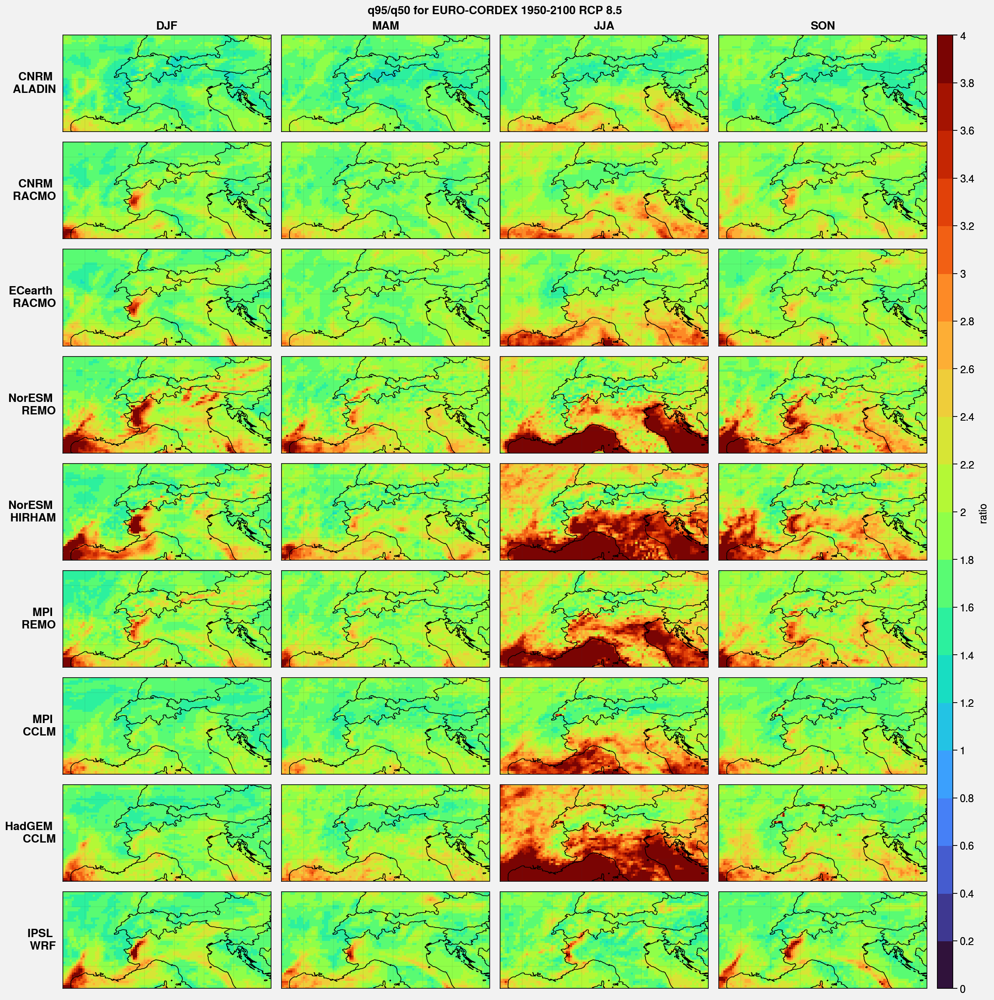

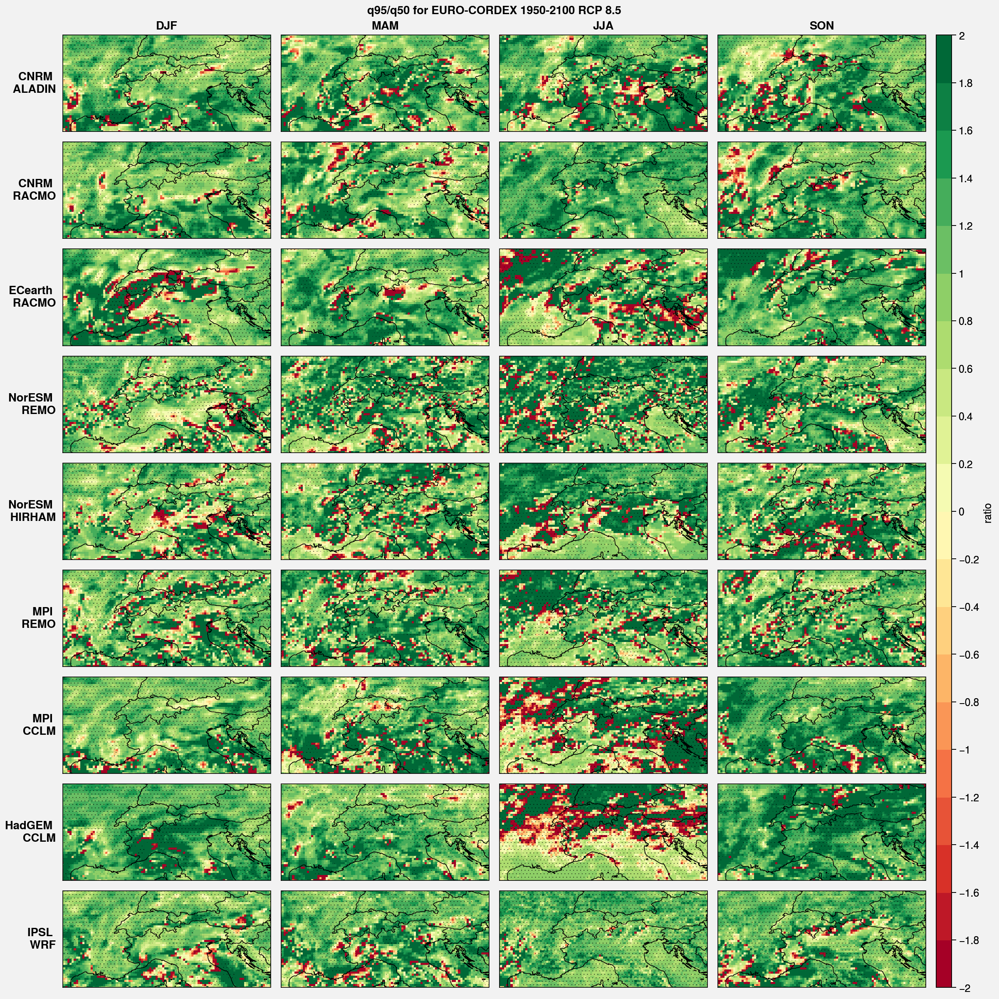

In [8]:
nsgev_models = np.load('/home/philinat/Stage-M2/saved_nsgev/nsgev_EUROCORDEX.npy')


def Qgev(μ,σ,ξ,q):
    Q = np.zeros(np.shape(μ))
    gumbel = np.abs(ξ)<10**-3
    gev = np.logical_not(gumbel)
    Q[gumbel] = μ[gumbel] - σ[gumbel]*np.log(-np.log(q))
    Q[gev] = μ[gev] + σ[gev]/ξ[gev]*((-np.log(q))**(-ξ[gev]) -1)
    return Q

for trend in [False,True]:
    
        f, axs = pplt.subplots(proj='cyl',ncols=4, nrows=len(nsgev_models))
        for m,params in enumerate(nsgev_models):
            for i in range(4):
                ax = axs[i+m*4]
                Q050 = Qgev(params[i,:,:,0],params[i,:,:,1],params[i,:,:,2],50/100)
                Q095 = Qgev(params[i,:,:,0],params[i,:,:,1],params[i,:,:,2],95/100)
                if trend:
                    Qt50 = Qgev(params[i,:,:,3],params[i,:,:,4],params[i,:,:,2],50/100)
                    Qt95 = Qgev(params[i,:,:,3],params[i,:,:,4],params[i,:,:,2],95/100)
                    cb = ax.pcolormesh(lon,lat,(Qt95/Q095)/(Qt50/Q050),levels=np.linspace(-2,2,21),cmap='RdYlGn')
                    signif=np.where(params[i,:,:,5]<0.05,True,False)
                    ax.contourf(lon,lat,signif,hatches=["", "...."], alpha=0.)
                else:
                    cb = ax.pcolormesh(lon,lat,Q095/Q050,levels=np.linspace(0,4,21),cmap='turbo')
        f.colorbar(cb, label= 'ratio ')         
        models = ['CNRM \n ALADIN','CNRM \n RACMO','ECearth \n RACMO','NorESM \n REMO','NorESM \n HIRHAM','MPI \n REMO','MPI \n CCLM','HadGEM \n CCLM','IPSL \n WRF']
        axs.format(**EUROCORDEX_format,suptitle='q95/q50 for EURO-CORDEX 1950-2100 RCP 8.5',collabels=['DJF','MAM','JJA', 'SON'],rowlabels=models)

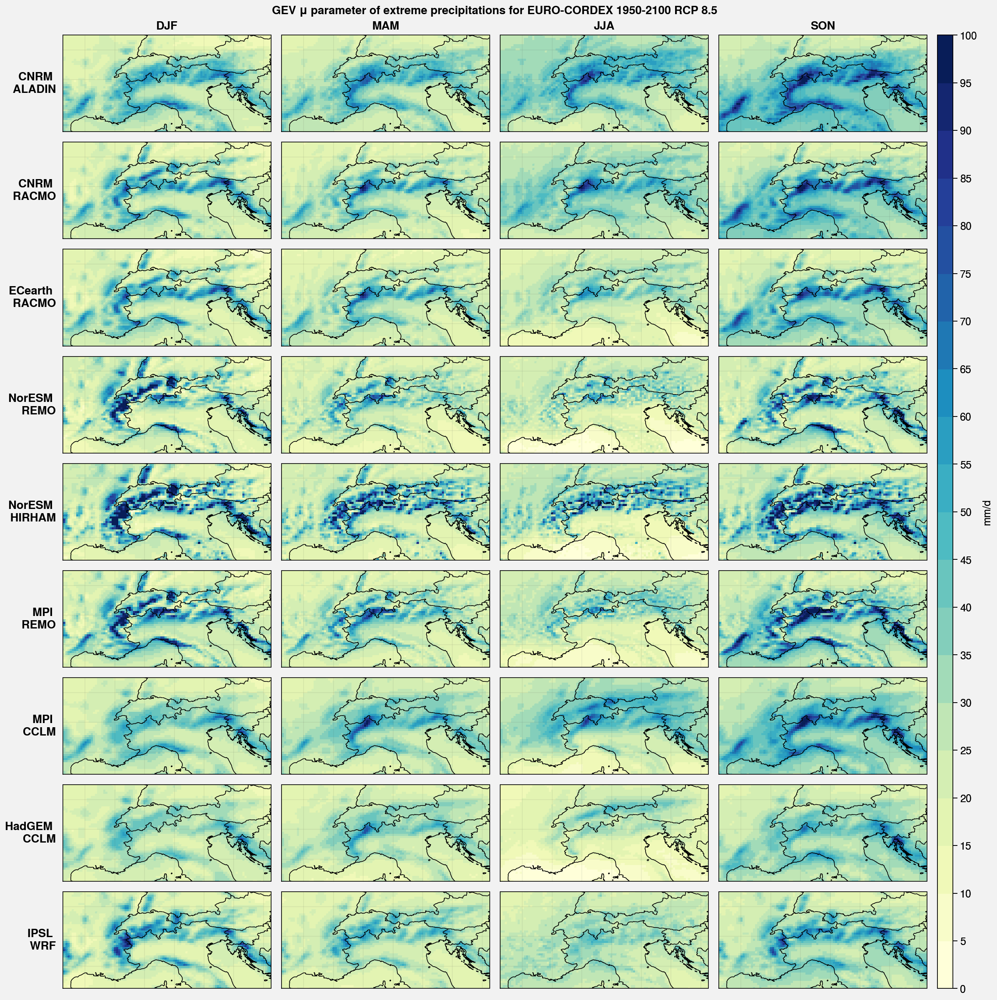

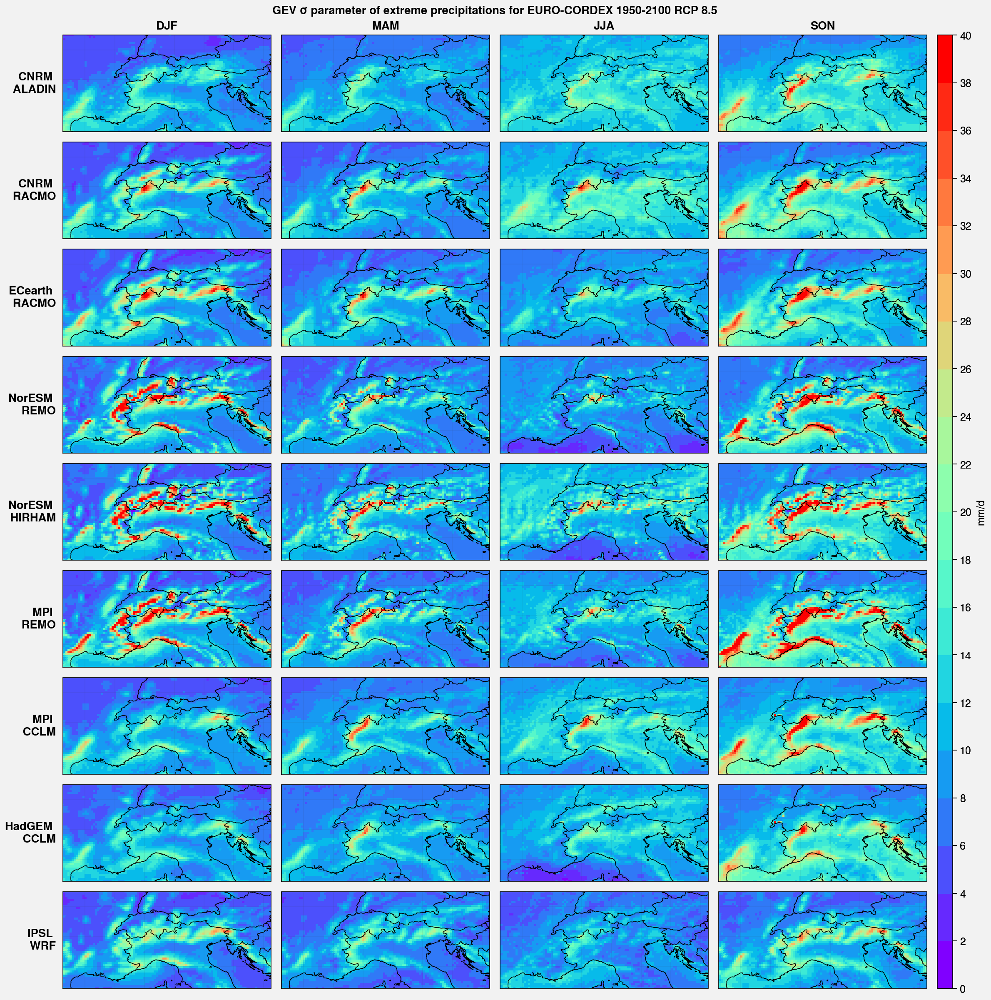

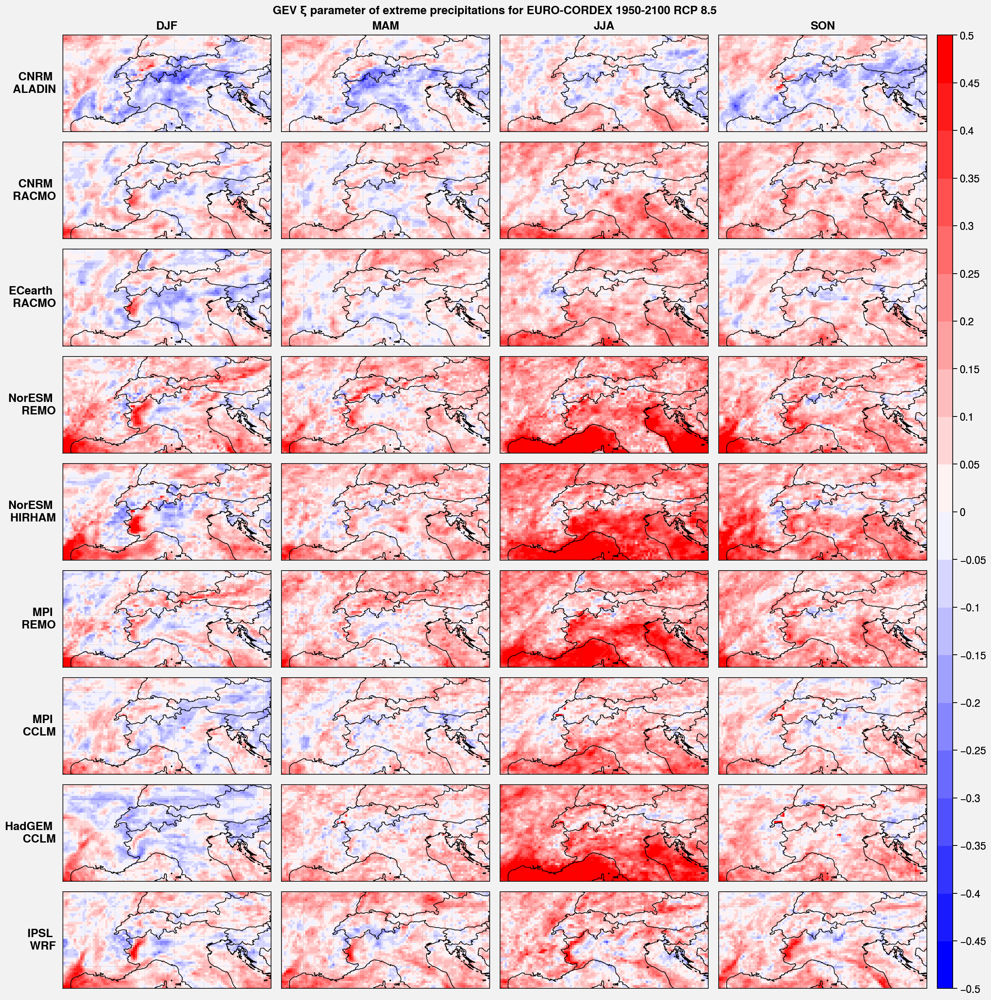

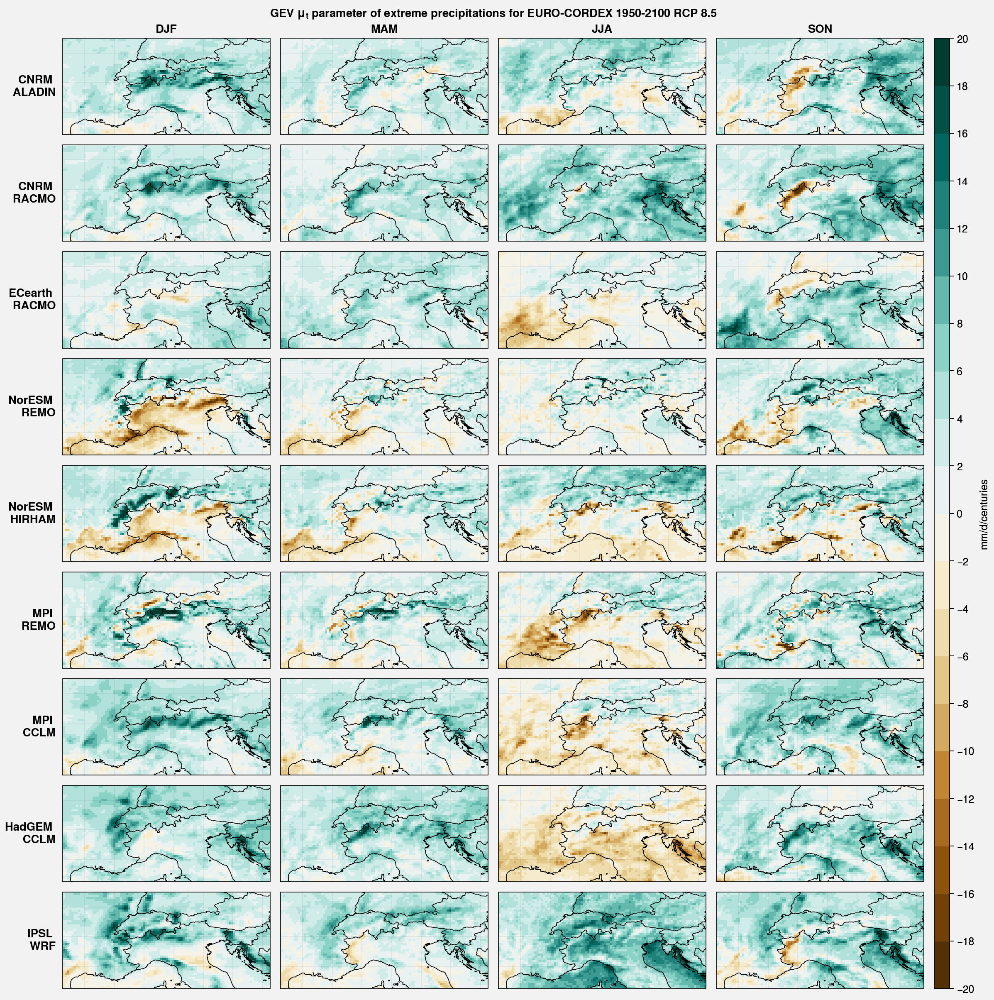

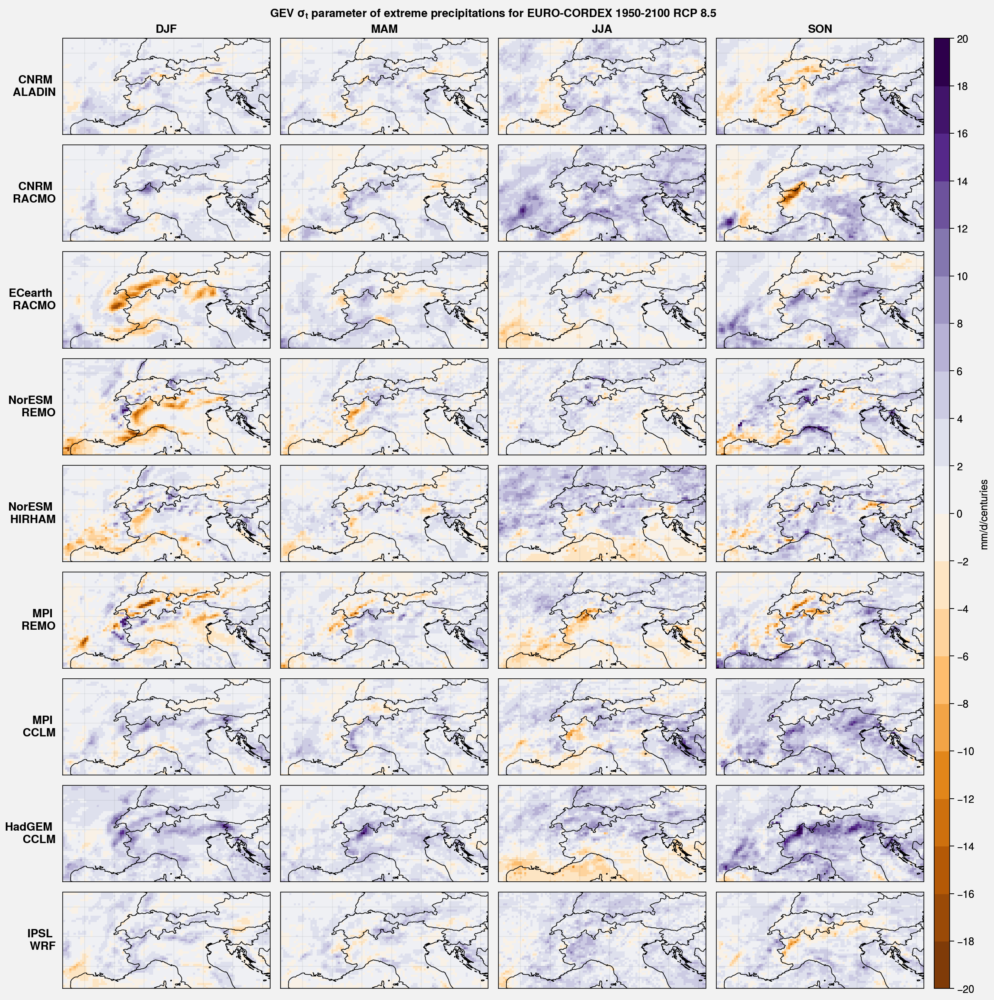

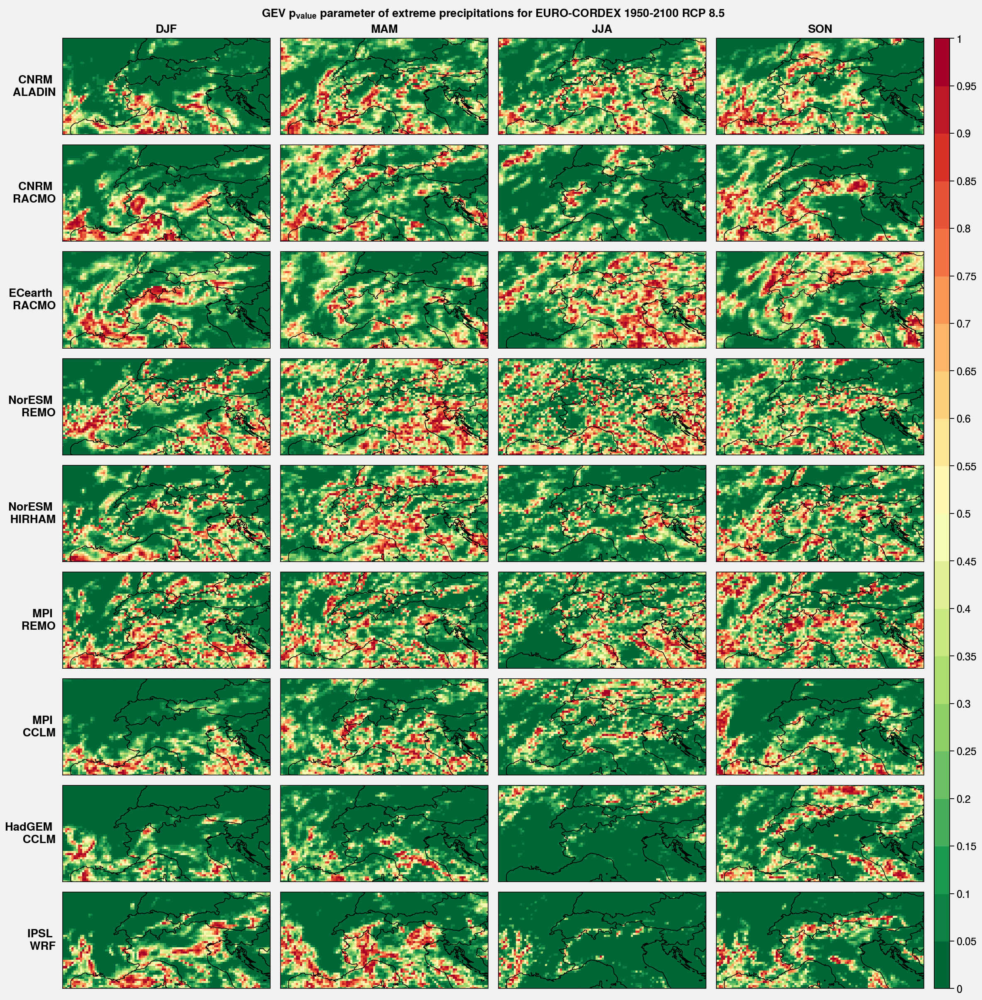

In [39]:
param_names = ['μ','σ','ξ','$μ_t$','$σ_t$','$p_{value}$']
les_levels = [np.linspace(0,100,21),np.linspace(0,40,21),np.linspace(-0.5,0.5,21),np.linspace(-20,20,21),np.linspace(-20,20,21),np.linspace(0,1,21)]
les_cmap = ['YlGnBu','rainbow','bwr','BrBg','PuOr','RdYlGn_r']
les_labels = ['mm/d','mm/d',None,'mm/d/centuries','mm/d/centuries',None]
for p,name in enumerate(param_names):
    f, axs = pplt.subplots(proj='cyl',ncols=4, nrows=len(nsgev_models))
    for m,params in enumerate(nsgev_models):
        for i in range(4):
            ax = axs[i+m*4]
            if p==3 or p==4:
                cb = ax.pcolormesh(lon,lat,100*params[i,:,:,p],levels=les_levels[p],cmap=les_cmap[p])
            else:
                cb = ax.pcolormesh(lon,lat,params[i,:,:,p],levels=les_levels[p],cmap=les_cmap[p])
    f.colorbar(cb, label= les_labels[p])         
    models = ['CNRM \n ALADIN','CNRM \n RACMO','ECearth \n RACMO','NorESM \n REMO','NorESM \n HIRHAM','MPI \n REMO','MPI \n CCLM','HadGEM \n CCLM','IPSL \n WRF']
    axs.format(**EUROCORDEX_format,suptitle='GEV '+name+' parameter of extreme precipitations for EURO-CORDEX 1950-2100 RCP 8.5',collabels=['DJF','MAM','JJA', 'SON'],rowlabels=models)    

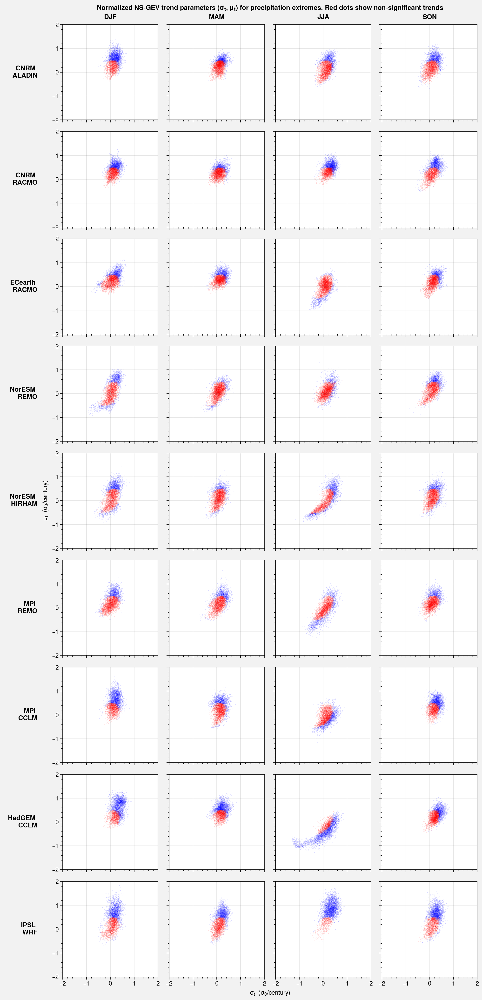

In [3]:
nsgev_models = np.load('/home/philinat/Stage-M2/saved_nsgev/nsgev_EUROCORDEX.npy')
f, axs = pplt.subplots(figsize=(10,None),ncols=4, nrows=len(nsgev_models))
for m,params in enumerate(nsgev_models):
    for i in range(4):
        ax = axs[i+m*4]
        signif=np.where(params[i,:,:,5]<0.05,True,False)
        notsignif=np.where(params[i,:,:,5]>0.05,True,False)
        mu_ = 100*params[i,:,:,3]/params[i,:,:,1]
        si_ = 100*params[i,:,:,4]/params[i,:,:,1]
        ax.scatter(np.ndarray.flatten(si_[signif],order='F'),np.ndarray.flatten(mu_[signif],order='F'),marker='.',alpha=0.1,color='b',s=1)
        ax.scatter(np.ndarray.flatten(si_[notsignif],order='F'),np.ndarray.flatten(mu_[notsignif],order='F'),marker='.',alpha=0.1,color='r',s=1)
        ax.set_xlim([-2,2])
        ax.set_ylim([-2,2])
        ax.set_xlabel('$\sigma_t$  $(\sigma_0 / century)$')
        ax.set_ylabel('$\mu_t$  $(\sigma_0 / century)$')
models = ['CNRM \n ALADIN','CNRM \n RACMO','ECearth \n RACMO','NorESM \n REMO','NorESM \n HIRHAM','MPI \n REMO','MPI \n CCLM','HadGEM \n CCLM','IPSL \n WRF']
axs.format(suptitle='Normalized NS-GEV trend parameters $(\sigma_t ,\mu_t)$ for precipitation extremes. Red dots show non-significant trends',collabels=['DJF','MAM','JJA', 'SON'],rowlabels=models)

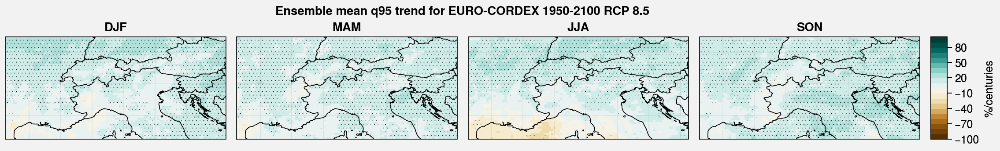

In [5]:
nsgev_models = np.load('/home/philinat/Stage-M2/saved_nsgev/nsgev_EUROCORDEX.npy')
for q in [95]:
    f, axs = pplt.subplots(proj='cyl',ncols=4, nrows=1)
    for m,params in enumerate(nsgev_models):
        for i in range(4):
            ax = axs[i]
            Q0 = Qgev(nsgev_models[:,i,:,:,0],nsgev_models[:,i,:,:,1],nsgev_models[:,i,:,:,2],q/100)
            Qt = Qgev(nsgev_models[:,i,:,:,3],nsgev_models[:,i,:,:,4],nsgev_models[:,i,:,:,2],q/100)
            trends = 100*100*Qt/Q0
            cb = ax.pcolormesh(lon,lat,np.mean(trends,axis=0),levels=np.linspace(-100,100,21),cmap='BrBg')
            signif=np.where(np.abs(np.sum(np.sign(trends),axis=0))>=6,True,False)
            ax.contourf(lon,lat,signif,hatches=["", "...."], alpha=0.)
    f.colorbar(cb, label= '%/centuries')        
    axs.format(**EUROCORDEX_format,suptitle='Ensemble mean q'+str(q)+' trend for EURO-CORDEX 1950-2100 RCP 8.5',collabels=['DJF','MAM','JJA', 'SON'])

Text(0.5, 1.0, 'Summer extreme events at lon=4.621212121212121 lat=43.34782608695652')

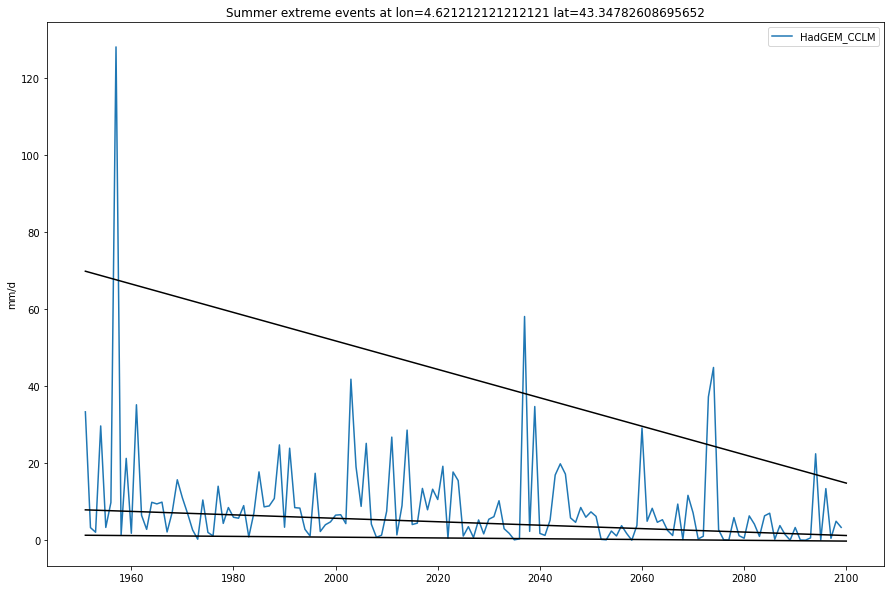

In [54]:
# models = ['CNRM_ALADIN','CNRM_RACMO','ECearth_RACMO','NorESM_REMO','NorESM_HIRHAM','MPI_REMO','MPI_CCLM','HadGEM_CCLM','IPSL_WRF']
models = ['HadGEM_CCLM']
i = 15
j = 40
plt.figure(figsize=(15,10))
for m,model in enumerate(models):
    les_season_max = np.load('/home/philinat/Stage-M2/season_max_EUROCORDEX/les_season_max_'+model+'.npy')[:,:,:,:]
    plt.plot(np.arange(1951,2100,1),les_season_max[:,2,j,i],label=model)
    μ0,σ0,ξ,μt,σt = nsgev_models[-2,2,j,i,:-1]
    half = 74
    μ1 = μ0-μt*half
    μ2 = μ0+μt*half
    σ1 = σ0-σt*half
    σ2 = σ0+σt*half
    for q in [0.95,0.05,0.5]:
        plt.plot([1951,2100],[Qgev(μ1,σ1,ξ,q),Qgev(μ2,σ2,ξ,q)],color='k')
plt.legend()
plt.ylabel("mm/d")
plt.title('Summer extreme events at lon='+str(lon[j,i])+' lat='+str(lat[j,i]))

In [56]:
σ1

5.6601428417003685

In [55]:
ξ

0.7651421323322802